# Pratical 4: A simple ice sheet model's sensitivity

This practical is to see how a simple ice sheet model (Shallow Ice Approximation) reacts to changes in its parameters and forcing.

First, we load in the relevant libraries

In [1]:
import numpy as np
import matplotlib.pyplot as plt

Next, we define a universal function that is able to take in many different inputs. The goal is to be able to have users define an accumulation and bed function, and input that along with different parameters into the SIA function. 

In [2]:
def accum(x,X,t=None,ELA_amp=5000,cycle_period=1000):
    if t:
        ela = X/3 + +ELA_amp*np.sin(20*t/(cycle_period*np.pi))
    else:
        ela = X/3
    b = 1e-4*(ela-x)
    return b, ela

def bed(x): # not implemented yet
    return 0

def sia(dt = 0.004,
        dx = 200,
        T = 3000,
        X = 40000,
        A = 24*10**(-25),
        n = 3,
        print_period = 30000,
        accum_func=accum,
        transient_accum = False,
        ELA_amp=5000,
        cycle_period=1000):
    # Initiate constants
    seconds_per_year = 365*24*60*60      # approximate number of seconds in year
    A =  A * seconds_per_year  # The flow law parameter, units [Pa a] (original value from Cuffey and Paterson 24e-25, units Pa s]
    rho = 917                            # ice density,  units [kg/m^3]
    g = 10                               # acceleration due to gravity, units [m/s^2]
    e = 0.0001                           # preventing h from reaching zero
    
    # define grids
    t = np.linspace(0,T,round(T/dt))  # the time grid, units [years]
    Lt = t.size                       # record the length of the time grid for us
    x = np.linspace(0,X,round(X/dx))  # spatial grid, units [m]
    Lx = x.size                       # record the length of the spatial grid for us
    x_stag = x[0:-1] + 0.5*dx
    
    # Initial condition
    H = np.zeros((Lt,Lx))
    H[0,:] = e
    ela_t = np.zeros(Lt)
    ela_t[0] = X/3
    # iterate through time
    for timestep in np.arange(1,Lt):

        # only print a message when the remainder of the timestep number and `print_period` is zero. i.e. if print_period = 30000, this prints a message very 30,000th timestep.
        if timestep % print_period == 0:    
            print(f'{t[timestep]:.1f} out of {T} years')

        # save the old thickness vector
        H_old  = H[timestep-1,:]

        # (1) compute H on the staggered grid
        H_stag = (H_old[1:] + H_old[:-1])/2

        # (2) compute the surface slope on the staggered grid.
        alpha = -(H_old[1:] - H_old[:-1])/dx 

        # (3) compute the flux on the staggered grid
        q = 2*A/(n+2) * (rho * g * alpha)**n * H_stag**(n+2)  

        # (4) compute the ice thickness at the current time step
        dqdx = (q[1:]-q[:-1])/dx
        if transient_accum: 
            b,ela = accum_func(x[1:-1],X,t[timestep],ELA_amp,cycle_period)
        else:
            b,ela = accum_func(x[1:-1],X,)
        ela_t[timestep]=ela
        H[timestep,1:-1] = (b - dqdx)*dt + H_old[1:-1]

        # apply the boundary conditions at x = 0 and x = X
        H[timestep,0] = H[timestep,1]
        H[timestep,:][H[timestep,:]<e] = e
    
    return x, x_stag, t, H, ela_t, q


Let's run it with the defaults settings and plot the final ice thickness profile

In [3]:
x,x_stag,t,H,ela_t,q = sia()

120.0 out of 3000 years
240.0 out of 3000 years
360.0 out of 3000 years
480.0 out of 3000 years
600.0 out of 3000 years
720.0 out of 3000 years
840.0 out of 3000 years
960.0 out of 3000 years
1080.0 out of 3000 years
1200.0 out of 3000 years
1320.0 out of 3000 years
1440.0 out of 3000 years
1560.0 out of 3000 years
1680.0 out of 3000 years
1800.0 out of 3000 years
1920.0 out of 3000 years
2040.0 out of 3000 years
2160.0 out of 3000 years
2280.0 out of 3000 years
2400.0 out of 3000 years
2520.0 out of 3000 years
2640.0 out of 3000 years
2760.0 out of 3000 years
2880.0 out of 3000 years


Text(0, 0.5, 'ice thickness, h [m]')

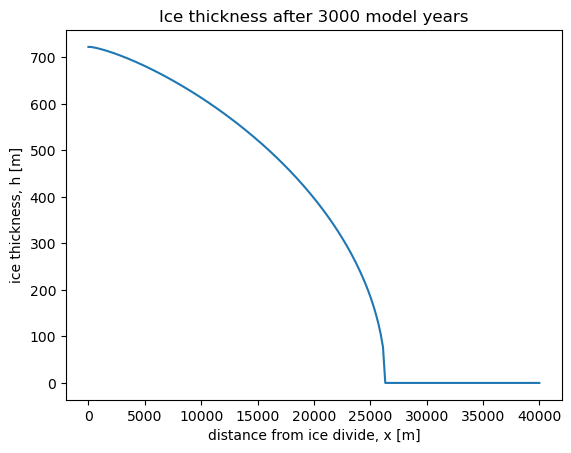

In [4]:
plt.plot(x,H[-1,:])
plt.title('Ice thickness after 3000 model years')
plt.xlabel('distance from ice divide, x [m]')
plt.ylabel('ice thickness, h [m]')

## Part 1: Sensitivity to flow law constant, A
We will input different values of A, and compare it with different metrics, namely the final ice thickness at the divide, the maximum ice flow rate, q, and the glacier terminus position, $x_g$.

In [5]:
A_array = np.logspace(-26, -21, num=10)
print('A values used:')
for A in A_array:
    print(f'A = {A}')

A values used:
A = 1e-26
A = 3.59381366380464e-26
A = 1.2915496650148826e-25
A = 4.641588833612792e-25
A = 1.6681005372000556e-24
A = 5.994842503189421e-24
A = 2.154434690031878e-23
A = 7.742636826811278e-23
A = 2.7825594022071144e-22
A = 1e-21


We now try the different A and compute the relevant variables. We define a function that determines the approximate glacier terminus position.

In [6]:
def gl_from_Hx(H,x):
    e = 0.0001
    ind = next(x for x, val in reversed(list(enumerate(H[-1,:]))) if val > e)
    return x[ind]

H_array = []
q_array = []
xg_array = []
for A in A_array:
    print(f'A = {A}')
    x,x_stag,t,H,ela_t,q = sia(A = A, print_period = 1000000)
    H_array.append(H[-1,0])
    q_array.append(np.max(q))
    xg_array.append(gl_from_Hx(H,x))

A = 1e-26
A = 3.59381366380464e-26
A = 1.2915496650148826e-25
A = 4.641588833612792e-25
A = 1.6681005372000556e-24
A = 5.994842503189421e-24
A = 2.154434690031878e-23
A = 7.742636826811278e-23
A = 2.7825594022071144e-22
A = 1e-21


Plotting these metrics with A.

Text(0.5, 1.0, 'Ice divide thickness, maximum flow rate, and glacier terminus position as a function of flow law parameter A')

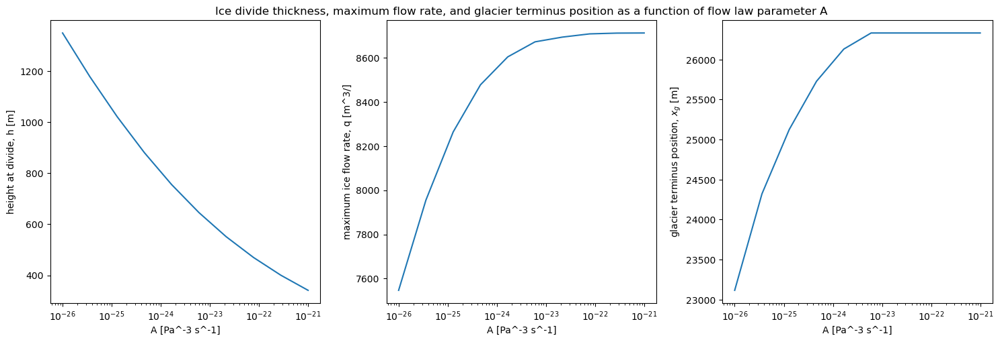

In [7]:
fig,ax = plt.subplots(ncols=3,figsize=(15,5))
ax[0].plot(A_array,H_array)
ax[0].set_xscale('log')
ax[0].set_xlabel('A [Pa^-3 s^-1]')
ax[0].set_ylabel('height at divide, h [m]')
ax[1].plot(A_array,q_array)
ax[1].set_xscale('log')
ax[1].set_xlabel('A [Pa^-3 s^-1]')
ax[1].set_ylabel('maximum ice flow rate, q [m^3/]')
ax[2].plot(A_array,xg_array)
ax[2].set_xscale('log')
ax[2].set_xlabel('A [Pa^-3 s^-1]')
ax[2].set_ylabel('glacier terminus position, $x_g$ [m]')
plt.tight_layout()
ax[1].set_title('Ice divide thickness, maximum flow rate, and glacier terminus position as a function of flow law parameter A')



We see that increasing A results in an overall thinner and longer glacier, with faster maximum ice flow. On the other hand, decreasing A gives thicker glaciers that don't flow as far, and flow at smaller speeds. We use these relations to understand that A is representative of the stiffness of the ice; stiffer ice (lower A) will not stretch as much as softer ice (higher A), so the stiffer ice tends to not flow as far and stay accumulating, resulting in the larger h at the divide. The softer ice will deform and slide further, hence the lower h at the divide.

## Part 2: Applying transient forcing
We allow transience in the accumulation function to occur with our default setting, a millenial scale oscillation.

In [8]:
x,x_stag,t,H,ela_t,q = sia(transient_accum = True)

120.0 out of 3000 years
240.0 out of 3000 years
360.0 out of 3000 years
480.0 out of 3000 years
600.0 out of 3000 years
720.0 out of 3000 years
840.0 out of 3000 years
960.0 out of 3000 years
1080.0 out of 3000 years
1200.0 out of 3000 years
1320.0 out of 3000 years
1440.0 out of 3000 years
1560.0 out of 3000 years
1680.0 out of 3000 years
1800.0 out of 3000 years
1920.0 out of 3000 years
2040.0 out of 3000 years
2160.0 out of 3000 years
2280.0 out of 3000 years
2400.0 out of 3000 years
2520.0 out of 3000 years
2640.0 out of 3000 years
2760.0 out of 3000 years
2880.0 out of 3000 years


Animating evolution with forcing

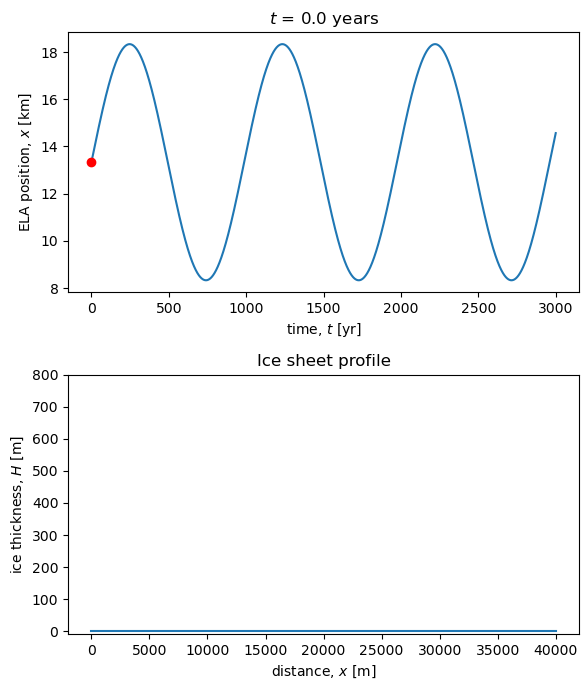

In [9]:
from matplotlib import animation, rc
from IPython.display import HTML
rc('animation', html='jshtml')

# Initial frame
fig, axs = plt.subplots(2,figsize = (6,7))
axs[0].plot(t,ela_t/1000)
axs[0].set_ylabel('ELA position, $x$ [km]')
axs[0].set_title(f"$t$ = {t[0]:.1f} years")
axs[0].set_xlabel('time, $t$ [yr]')
point, = axs[0].plot(t[0],ela_t[0]/1000,'ro')
line, = axs[1].plot(x,H[0,:])
axs[1].set_ylim(-10,800)
axs[1].set_xlabel('distance, $x$ [m]')
axs[1].set_ylabel('ice thickness, $H$ [m]')
axs[1].set_title('Ice sheet profile')
plt.tight_layout()
plt.show()

def animate(timestep):
    line.set_data(x, H[timestep,:])                 # update the data
    point.set_data(t[timestep],ela_t[timestep]/1000)
    axs[0].set_title(f"$t$ = {t[timestep]:.1f} years")  # update the title


anim = animation.FuncAnimation(fig, animate, frames=np.arange(0, len(t), 4000), interval = 200, repeat=True)


In [10]:
HTML(anim.to_jshtml())


/tmp/ipykernel_599/3021777557.py:22: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  point.set_data(t[timestep],ela_t[timestep]/1000)


We can see what appears to be a lag with the forcing, but once the ice sheet is past its "spin up", it seems to go through similar cycles of advance and retreat as the forcing. Let's see what happens with centennial scale oscillations. 

In [11]:
x_100,x_stag_100,t_100,H_100,ela_t_100,q_100 = sia(transient_accum = True,cycle_period=100)

120.0 out of 3000 years
240.0 out of 3000 years
360.0 out of 3000 years
480.0 out of 3000 years
600.0 out of 3000 years
720.0 out of 3000 years
840.0 out of 3000 years
960.0 out of 3000 years
1080.0 out of 3000 years
1200.0 out of 3000 years
1320.0 out of 3000 years
1440.0 out of 3000 years
1560.0 out of 3000 years
1680.0 out of 3000 years
1800.0 out of 3000 years
1920.0 out of 3000 years
2040.0 out of 3000 years
2160.0 out of 3000 years
2280.0 out of 3000 years
2400.0 out of 3000 years
2520.0 out of 3000 years
2640.0 out of 3000 years
2760.0 out of 3000 years
2880.0 out of 3000 years


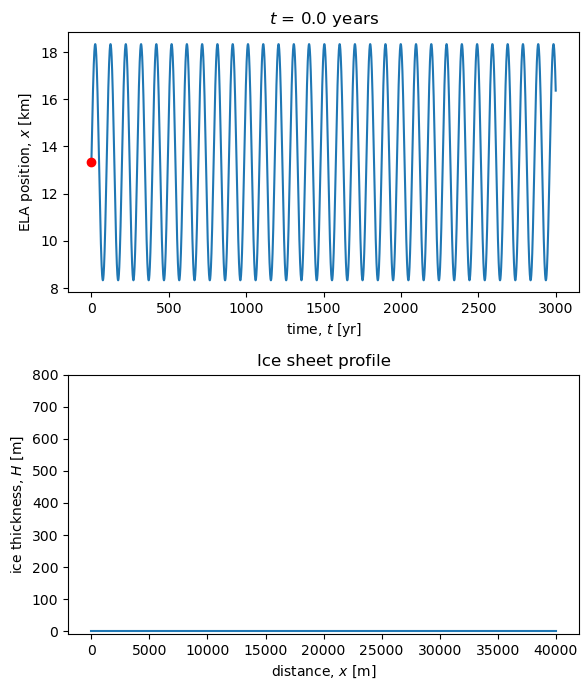

In [12]:
from matplotlib import animation, rc
from IPython.display import HTML
rc('animation', html='jshtml')

# Initial frame
fig, axs = plt.subplots(2,figsize = (6,7))
axs[0].plot(t_100,ela_t_100/1000)
axs[0].set_ylabel('ELA position, $x$ [km]')
axs[0].set_title(f"$t$ = {t_100[0]:.1f} years")
axs[0].set_xlabel('time, $t$ [yr]')
point, = axs[0].plot(t_100[0],ela_t_100[0]/1000,'ro')
line, = axs[1].plot(x_100,H_100[0,:])
axs[1].set_ylim(-10,800)
axs[1].set_xlabel('distance, $x$ [m]')
axs[1].set_ylabel('ice thickness, $H$ [m]')
axs[1].set_title('Ice sheet profile')
plt.tight_layout()
plt.show()

def animate(timestep):
    line.set_data(x_100, H_100[timestep,:])                 # update the data
    point.set_data(t_100[timestep],ela_t_100[timestep]/1000)
    axs[0].set_title(f"$t$ = {t_100[timestep]:.1f} years")  # update the title


anim = animation.FuncAnimation(fig, animate, frames=np.arange(0, len(t), 4000), interval = 200, repeat=True)


In [13]:
HTML(anim.to_jshtml())


/tmp/ipykernel_599/2764525117.py:22: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  point.set_data(t_100[timestep],ela_t_100[timestep]/1000)


We see that even with the same amplitude of forcing, the ice sheet doesn't have as drastic as a response as with the millenium scale forcing, further suggesting some sort of delay with this specific configuration. Plotting the forcing with the ice divide thickness shows this lag. Futher experiments changing the amplitude of forcing could help paint a better picture of the full range of ice sheet responses to forcing. 

Text(0.5, 0, 'time [yrs]')

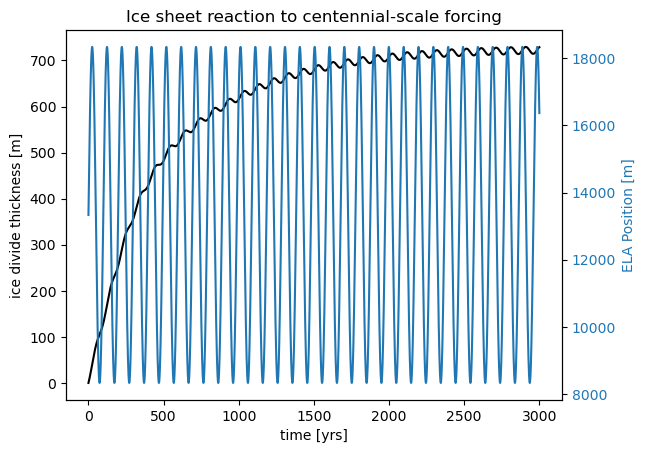

In [22]:
fig, ax1 = plt.subplots()
ax1.plot(t_100,H_100[:,0],color='black')
ax1.set_ylabel('ice divide thickness [m]', color='black')
ax1.tick_params(axis='y', labelcolor='black')
ax2 = ax1.twinx() 
ax2.plot(t_100,ela_t_100,color='tab:blue')
ax2.set_ylabel('ELA Position [m]', color='tab:blue')
ax2.tick_params(axis='y', labelcolor='tab:blue')
plt.title('Ice sheet reaction to centennial-scale forcing')
ax1.set_xlabel('time [yrs]')

Text(0.5, 0, 'time [yrs]')

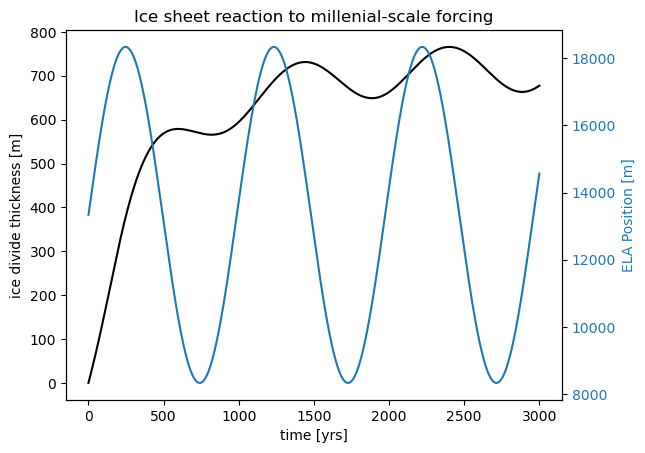

In [23]:
fig, ax1 = plt.subplots()
ax1.plot(t,H[:,0],color='black')
ax1.set_ylabel('ice divide thickness [m]', color='black')
ax1.tick_params(axis='y', labelcolor='black')
ax2 = ax1.twinx() 
ax2.plot(t,ela_t,color='tab:blue')
ax2.set_ylabel('ELA Position [m]', color='tab:blue')
ax2.tick_params(axis='y', labelcolor='tab:blue')
plt.title('Ice sheet reaction to millenial-scale forcing')
ax1.set_xlabel('time [yrs]')

Finally, plotting the phase of ELA position versus the ice thickness, we can see directly how the two relate. 


Text(0, 0.5, 'ice sheet divide thickness [m]')

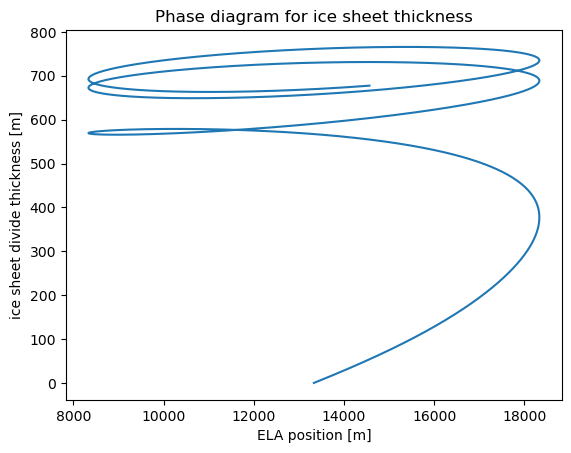

In [25]:
plt.plot(ela_t,H[:,0])
plt.title('Phase diagram for ice sheet thickness')
plt.xlabel('ELA position [m]')
plt.ylabel('ice sheet divide thickness [m]')

We can see that the line gradually approaches a elliptical pattern, indicating that eventually, the ice sheet behavior approaches a cycle.
The tilt and shape of the final elliptical pattern indicates the phase relationship. It shows how the peak in H is not where the peak in ELA occurs, but rather slightly afterwards. 